<a href="https://colab.research.google.com/github/pachon00/03MAIR-Algoritmos-de-optimizacion/blob/master/Defectos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#  Comprensión del negocio.

Set de datos con origen en un equipo de inspeccion de defectos.


# Importación de datos

In [0]:
import pandas as pd



In [0]:
data_url = 'https://drive.google.com/file/d/1sFN8RzW62GxZHBp91C0GjQp8S604ccon'
id = '1sFN8RzW62GxZHBp91C0GjQp8S604ccon'

In [4]:
!pip install -U -q PyDrive
!pip3 install seaborn==0.9.0
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

# Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)
link = data_url

print (id) # Verify that you have everything after '='

downloaded = drive.CreateFile({'id':id}) 
downloaded.GetContentFile('Filename.csv')  
df = pd.read_csv('Filename.csv', sep = '\t')

df.head()

    100% |████████████████████████████████| 993kB 11.9MB/s 
    100% |████████████████████████████████| 215kB 25.7MB/s 
  Found existing installation: seaborn 0.7.1
    Uninstalling seaborn-0.7.1:
      Successfully uninstalled seaborn-0.7.1


1sFN8RzW62GxZHBp91C0GjQp8S604ccon


,Unnamed: 0,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,...,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Pastry,Z_Scratch,K_Scatch,Stains,Dirtiness,Bumps,Other_Faults
0,1309,1343,1351,46714,46725,56,11,11,5729,90,...,0.2727,-0.2007,0.1934,0,0,0,0,0,0,1
1,1132,354,370,409908,409918,116,19,10,12174,82,...,-0.3750,-0.1801,0.2792,0,0,0,0,0,1,0
2,1230,1056,1077,4364066,4364076,106,35,22,10747,89,...,-0.5238,-0.2079,0.3509,0,0,0,0,0,1,0
3,783,816,822,899659,899665,18,8,6,2384,127,...,0.0000,0.0347,0.1449,0,0,0,1,0,0,0
4,1762,78,94,1523381,1523431,463,69,54,60518,118,...,0.6800,0.0212,0.9650,0,0,0,0,0,0,1


In [43]:
df.shape()

(1455, 37)

# Exploración rápida

In [0]:
# Quitar columna de índice
df = df.drop(columns=['Unnamed: 0'])

In [6]:
pd.set_option('display.max_columns', 500) ## Aumentar el máximo de columnas
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
X_Minimum,1455.0,5.700351e+02,5.166412e+02,0.0000,56.00000,4.350000e+02,1.046500e+03,1.705000e+03
X_Maximum,1455.0,6.163052e+02,4.935435e+02,4.0000,194.00000,4.660000e+02,1.070000e+03,1.713000e+03
Y_Minimum,1455.0,1.676894e+06,1.826262e+06,6712.0000,502694.00000,1.223690e+06,2.183653e+06,1.298766e+07
Y_Maximum,1455.0,1.676950e+06,1.826278e+06,6724.0000,502804.50000,1.223696e+06,2.183658e+06,1.298769e+07
Pixels_Areas,1455.0,1.908098e+03,5.540549e+03,2.0000,82.50000,1.720000e+02,7.940000e+02,1.526550e+05
X_Perimeter,1455.0,1.136447e+02,3.312330e+02,2.0000,15.00000,2.600000e+01,8.250000e+01,1.044900e+04
Y_Perimeter,1455.0,8.591409e+01,4.879967e+02,1.0000,13.00000,2.500000e+01,8.300000e+01,1.815200e+04
Sum_of_Luminosity,1455.0,2.069553e+05,5.333202e+05,250.0000,9374.00000,1.898600e+04,8.165950e+04,1.159141e+07
Minimum_of_Luminosity,1455.0,8.466117e+01,3.237587e+01,0.0000,63.00000,9.000000e+01,1.060000e+02,2.030000e+02
Maximum_of_Luminosity,1455.0,1.300220e+02,1.846196e+01,37.0000,124.00000,1.270000e+02,1.400000e+02,2.470000e+02



## Funciones helpers (esteban_helpers)



In [0]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

import math
from scipy import stats


def plotdists(df, numcols=3, alpha=0.05, showy=False, c_mean='g', c_stdev='orange', 
              normtest=True, leg_pos='upper right', return_fig=False, xlim=False, 
              row_height=5, col_width=5, xtick_rotation=None, tight=True, **kwargs):
    # Verify that df is a dataframe
    if not isinstance(df, pd.core.frame.DataFrame):
        print(u'The df given is not a dataframe!')
        return
    # Select numeric and categorical variables
    df = df.select_dtypes(include=['number', 'object'])
    # Select only numeric variables for normality test
    df_num = df.select_dtypes(include='number')
    # Apply normaltest
    if normtest and df.dropna().shape[0] > 8:
        statistic, p_vals = stats.normaltest(df_num.dropna())
        # Create dictionaries containing the stats
        statistic = dict(zip(df_num.columns, statistic))
        p_vals = dict(zip(df_num.columns, p_vals))
    # Generate the plots
    numrows = math.ceil(float(len(df.columns))/numcols)
    fig = plt.figure(figsize=(numcols*col_width, numrows*row_height))
    i = 1
    for col in df.columns:
        if type(xlim) == list:
            plt.subplot(numrows, numcols, i, xlim=xlim[i-1])
        elif type(xlim) == tuple:
            plt.subplot(numrows, numcols, i, xlim=xlim)
        else:
            plt.subplot(numrows, numcols, i)
        NumNans = df[col].isna().sum()
        if NumNans == len(df):
            continue
        # For categorical variables:
        elif df[col].dtype == object:
            df.loc[np.logical_not(df[col].isnull()), col] = df.loc[np.logical_not(df[col].isnull()), col].apply(lambda x: unicode(x, "utf-8"))
            sns.countplot(x=col, data=df, **kwargs)
            if xtick_rotation is not None:
                plt.xticks(rotation=xtick_rotation)
            plt.xlabel('')
            # plt.text(x=0.01, y=0.9, s=u'NaNs: {}'.format(NumNans), transform=plt.gca().transAxes, fontsize=10)
        # For numerical variables:
        elif df[col].dtype in (int, np.long, float, complex):
            mean = df[col].mean()
            stdev = df[col].std()
            
            sns.distplot(df[col].dropna(), norm_hist=True, axlabel=False, ax=plt.gca(), **kwargs)
            # Get the current y limits to draw vertical lines
            ylims = plt.gca().get_ylim()
            # Add a line for the mean
            plt.plot([mean]*2, ylims, label='mean', c=c_mean)
            # Add lines at mean +/- 2 standard deviations
            plt.plot([mean+stdev*2]*2, ylims, label='+/- 2 StDev', c=c_stdev)
            plt.plot([mean-stdev*2]*2, ylims, c=c_stdev)
            # Restore y limits
            plt.ylim(ylims)
            # Add legend only of mean and one +/- 2 stdev line
            plt.legend(loc=leg_pos)
            # Remove y axis ticks
            if not showy:
                plt.yticks([])
            if normtest and df.dropna().shape[0] > 8:
                if p_vals[col] < alpha:
                    norm = "Not Gaussian"
                else:
                    norm = "Gaussian"
                plt.text(x=0.01, y=0.8, s=u'Statistic = {:.2f}\np-value = {:.2e}'.format(statistic[col], p_vals[col]) +
                         "\n"+norm, transform = plt.gca().transAxes, fontsize=10)
            # Or including number of NaNs:
            # plt.text(x=0.01, y=0.8, s=u'NaNs: {}\nStatistic = {:.2f}\np-value = {:.2e}'.format(NumNans, statistic[col], p_vals[col]) +
            #          "\n"+norm, transform = plt.gca().transAxes, fontsize=10)
        else:
            print('Column {} dtype cannot be plotted.'.format(col))
            continue
        plt.title(col)
        i += 1
    if tight:
        plt.tight_layout()
    if return_fig:
        plt.close()
        return fig
    else:
        return

## Distribuciones de probabilidad 

/usr/local/lib/python3.6/dist-packages/matplotlib/axes/_axes.py:6521: MatplotlibDeprecationWarning: 
The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.
  alternative="'density'", removal="3.1")


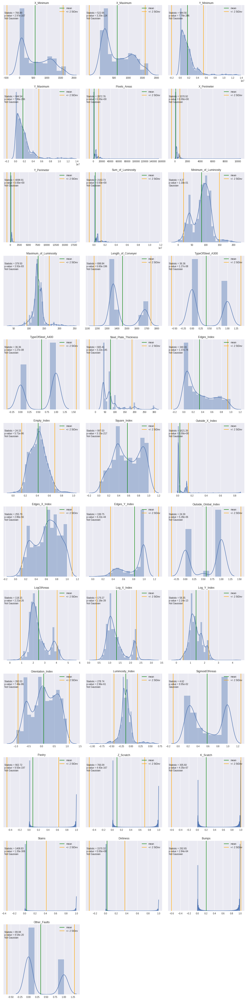

In [8]:
plotdists(df)

# Comprension de los datos



### Descripción de Caracteristicas

|Caracteristicas|Cantidad|
|---------------------|
|Nro de instancias|1455|
|Nro de clases|7|
|Nro de atributos|30|


### Descripción de Clases

|Nombre Clase |Tipo |
|---------------------|
|Pastry|Binary|
|Z_Scratch|Binary|
|K_Scatch|Binary|
|Stains|Binary|
|Dirtiness|Binary|
|Bumbs|Binary|
|Other_Faults|Binary|

### Descripción de Atributos

|Nombre atributo |Tipo |
|---------------------|
|X_Minimum|Numerico|
|X_Maximum|Numerico|
|Y_Minimum|Numerico|
|Y_Maximum'|Numerico|
|Pixels_Areas|Numerico|
|X_Perimeter|Numerico|
|Y_Perimeter|Numerico|
|Sum_of_Luminosity|Numerico|
|Minimum_of_Luminosity|Numerico|
|Maximum_of_Luminosity|Numerico|
|Length_of_Conveyer|Numerico|
|TypeOfSteel_A300|Categorico|
|TypeOfSteel_A400|Categorico|
|Steel_Plate_Thickness|Numerico|
|Edges_Index|Numerico|
|Empty_Index|Numerico|
|Square_Index|Numerico|
|Outside_X_Index|Numerico|
|Edges_X_Index|Numerico|
|Edges_Y_Index|Numerico|
|Outside_Global_Index|Numerico|
|LogOfAreas|Numerico|
|Log_X_Index|Numerico|
|Log_Y_Index|Numerico|
|Orientation_Index|Numerico|
|Luminosity_Index|Numerico|
|SigmoidOfAreas|Numerico|



## Agrupar por defecto

In [9]:
dummy_targets = ['Pastry', 'Z_Scratch', 'K_Scatch', 'Stains', 'Dirtiness', 'Bumps', 'Other_Faults']
features = [c for c in df.columns if c not in dummy_targets]
features


['X_Minimum',
 'X_Maximum',
 'Y_Minimum',
 'Y_Maximum',
 'Pixels_Areas',
 'X_Perimeter',
 'Y_Perimeter',
 'Sum_of_Luminosity',
 'Minimum_of_Luminosity',
 'Maximum_of_Luminosity',
 'Length_of_Conveyer',
 'TypeOfSteel_A300',
 'TypeOfSteel_A400',
 'Steel_Plate_Thickness',
 'Edges_Index',
 'Empty_Index',
 'Square_Index',
 'Outside_X_Index',
 'Edges_X_Index',
 'Edges_Y_Index',
 'Outside_Global_Index',
 'LogOfAreas',
 'Log_X_Index',
 'Log_Y_Index',
 'Orientation_Index',
 'Luminosity_Index',
 'SigmoidOfAreas']

In [10]:
x = df[dummy_targets].stack()
df['Defecto'] = pd.Series(pd.Categorical(x[x!=0].index.get_level_values(1)))
df[features + ['Defecto']]

,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,TypeOfSteel_A300,TypeOfSteel_A400,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Defecto
0,1343,1351,46714,46725,56,11,11,5729,90,117,1362,1,0,70,0.0161,0.3636,0.7273,0.0059,0.7273,1.0000,1.0,1.7482,0.9031,1.0414,0.2727,-0.2007,0.1934,Other_Faults
1,354,370,409908,409918,116,19,10,12174,82,126,1360,0,1,40,0.5206,0.2750,0.6250,0.0118,0.8421,1.0000,0.0,2.0645,1.2041,1.0000,-0.3750,-0.1801,0.2792,Bumps
2,1056,1077,4364066,4364076,106,35,22,10747,89,116,1362,1,0,80,0.4185,0.4952,0.4762,0.0154,0.6000,0.4545,0.0,2.0253,1.3222,1.0000,-0.5238,-0.2079,0.3509,Bumps
3,816,822,899659,899665,18,8,6,2384,127,141,1358,0,1,50,0.7894,0.5000,1.0000,0.0044,0.7500,1.0000,0.5,1.2553,0.7782,0.7782,0.0000,0.0347,0.1449,Stains
4,78,94,1523381,1523431,463,69,54,60518,118,141,1360,0,1,130,0.1147,0.4212,0.3200,0.0118,0.2319,0.9259,1.0,2.6656,1.2041,1.6990,0.6800,0.0212,0.9650,Other_Faults
5,618,650,2017425,2017438,103,51,20,13657,124,141,1358,0,1,40,0.9102,0.7524,0.4063,0.0236,0.6274,0.6500,0.0,2.0128,1.5051,1.1139,-0.5938,0.0359,0.6810,Other_Faults
6,39,192,1469673,1469845,13946,589,406,1635177,33,142,1402,0,1,40,0.0556,0.4701,0.8895,0.1091,0.2598,0.4236,1.0,4.1445,2.1847,2.2355,0.1105,-0.0840,1.0000,K_Scatch
7,1170,1184,1038876,1038891,113,27,18,14982,125,142,1362,1,0,70,0.2614,0.4619,0.9333,0.0103,0.5185,0.8333,1.0,2.0531,1.1461,1.1761,0.0667,0.0358,0.3509,Other_Faults
8,1027,1048,787015,787022,76,22,10,9934,109,148,1692,1,0,143,0.7612,0.4830,0.3333,0.0124,0.9546,0.7000,0.0,1.8808,1.3222,0.8451,-0.6667,0.0212,0.2621,Other_Faults
9,615,625,1398169,1398179,65,12,10,7104,89,126,1358,0,1,50,0.9057,0.3500,1.0000,0.0074,0.8333,1.0000,0.5,1.8129,1.0000,1.0000,0.0000,-0.1461,0.2061,Stains


/usr/local/lib/python3.6/dist-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


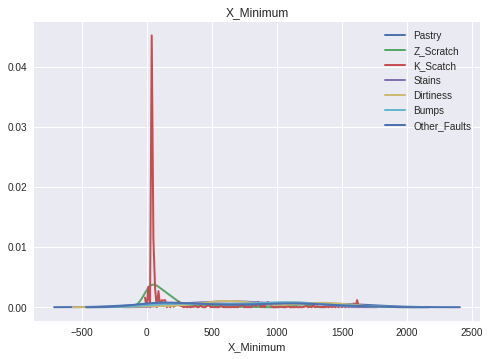

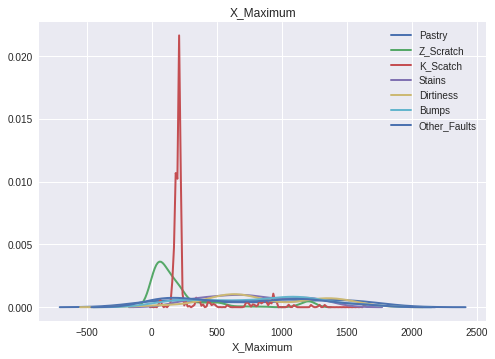

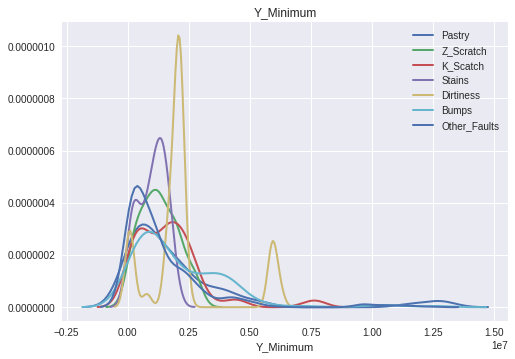

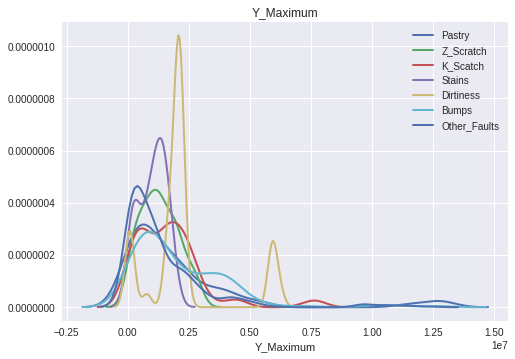

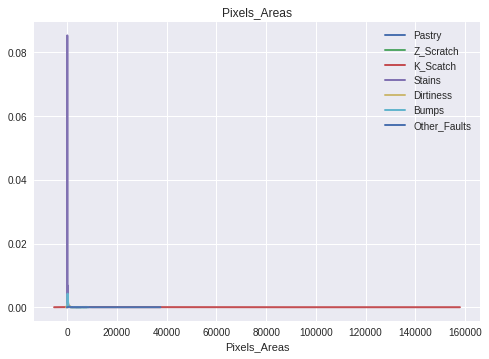

...

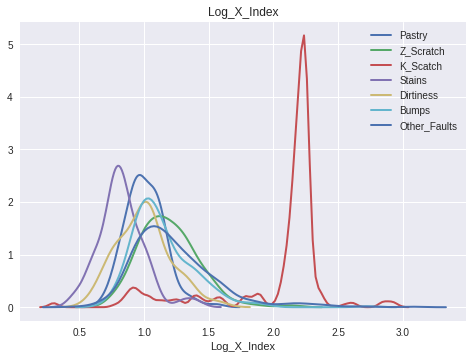

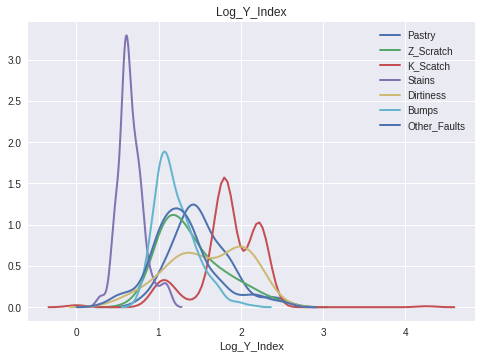

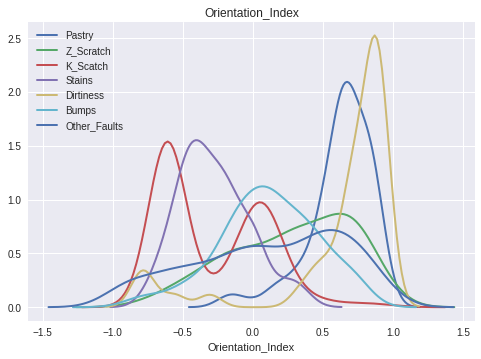

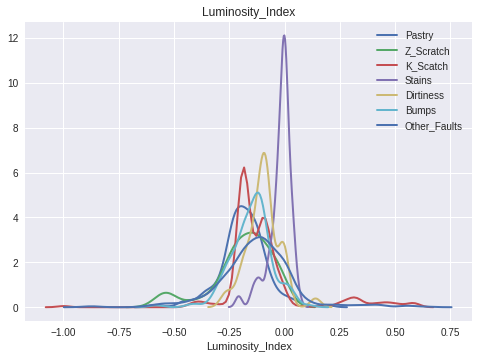

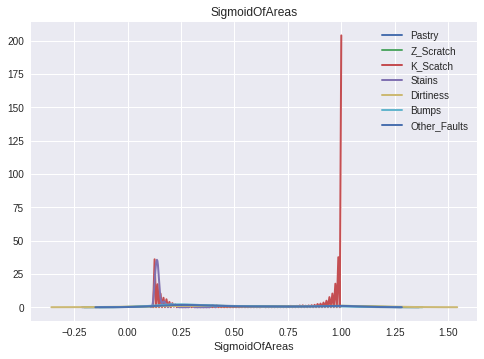

In [11]:
for feat in features:
  f, ax = plt.subplots()
  for defect in dummy_targets:
    subset = df[df['Defecto']==defect]
    sns.distplot(subset[feat], hist = False, kde = True, 
                 kde_kws = {'linewidth': 2},
                 label = defect)
    ax.set_title(feat)

In [12]:
dummy_steels = ['TypeOfSteel_A300', 'TypeOfSteel_A400']
features_steel = [c for c in features if c not in dummy_steels]
features_steel

['X_Minimum',
 'X_Maximum',
 'Y_Minimum',
 'Y_Maximum',
 'Pixels_Areas',
 'X_Perimeter',
 'Y_Perimeter',
 'Sum_of_Luminosity',
 'Minimum_of_Luminosity',
 'Maximum_of_Luminosity',
 'Length_of_Conveyer',
 'Steel_Plate_Thickness',
 'Edges_Index',
 'Empty_Index',
 'Square_Index',
 'Outside_X_Index',
 'Edges_X_Index',
 'Edges_Y_Index',
 'Outside_Global_Index',
 'LogOfAreas',
 'Log_X_Index',
 'Log_Y_Index',
 'Orientation_Index',
 'Luminosity_Index',
 'SigmoidOfAreas']

In [13]:
y = df[dummy_steels].stack()
df['TypeSteel'] = pd.Series(pd.Categorical(y[y!=0].index.get_level_values(1)))
df['TypeSteel']
x = df[dummy_targets].stack()
df['Defecto'] = pd.Series(pd.Categorical(x[x!=0].index.get_level_values(1)))
df[features_steel +['Defecto']+['TypeSteel']]

,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Defecto,TypeSteel
0,1343,1351,46714,46725,56,11,11,5729,90,117,1362,70,0.0161,0.3636,0.7273,0.0059,0.7273,1.0000,1.0,1.7482,0.9031,1.0414,0.2727,-0.2007,0.1934,Other_Faults,TypeOfSteel_A300
1,354,370,409908,409918,116,19,10,12174,82,126,1360,40,0.5206,0.2750,0.6250,0.0118,0.8421,1.0000,0.0,2.0645,1.2041,1.0000,-0.3750,-0.1801,0.2792,Bumps,TypeOfSteel_A400
2,1056,1077,4364066,4364076,106,35,22,10747,89,116,1362,80,0.4185,0.4952,0.4762,0.0154,0.6000,0.4545,0.0,2.0253,1.3222,1.0000,-0.5238,-0.2079,0.3509,Bumps,TypeOfSteel_A300
3,816,822,899659,899665,18,8,6,2384,127,141,1358,50,0.7894,0.5000,1.0000,0.0044,0.7500,1.0000,0.5,1.2553,0.7782,0.7782,0.0000,0.0347,0.1449,Stains,TypeOfSteel_A400
4,78,94,1523381,1523431,463,69,54,60518,118,141,1360,130,0.1147,0.4212,0.3200,0.0118,0.2319,0.9259,1.0,2.6656,1.2041,1.6990,0.6800,0.0212,0.9650,Other_Faults,TypeOfSteel_A400
5,618,650,2017425,2017438,103,51,20,13657,124,141,1358,40,0.9102,0.7524,0.4063,0.0236,0.6274,0.6500,0.0,2.0128,1.5051,1.1139,-0.5938,0.0359,0.6810,Other_Faults,TypeOfSteel_A400
6,39,192,1469673,1469845,13946,589,406,1635177,33,142,1402,40,0.0556,0.4701,0.8895,0.1091,0.2598,0.4236,1.0,4.1445,2.1847,2.2355,0.1105,-0.0840,1.0000,K_Scatch,TypeOfSteel_A400
7,1170,1184,1038876,1038891,113,27,18,14982,125,142,1362,70,0.2614,0.4619,0.9333,0.0103,0.5185,0.8333,1.0,2.0531,1.1461,1.1761,0.0667,0.0358,0.3509,Other_Faults,TypeOfSteel_A300
8,1027,1048,787015,787022,76,22,10,9934,109,148,1692,143,0.7612,0.4830,0.3333,0.0124,0.9546,0.7000,0.0,1.8808,1.3222,0.8451,-0.6667,0.0212,0.2621,Other_Faults,TypeOfSteel_A300
9,615,625,1398169,1398179,65,12,10,7104,89,126,1358,50,0.9057,0.3500,1.0000,0.0074,0.8333,1.0000,0.5,1.8129,1.0000,1.0000,0.0000,-0.1461,0.2061,Stains,TypeOfSteel_A400


### Tipo de Acero A300


/usr/local/lib/python3.6/dist-packages/numpy/core/_methods.py:135: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
/usr/local/lib/python3.6/dist-packages/numpy/core/_methods.py:127: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.6/dist-packages/statsmodels/nonparametric/kde.py:494: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X,a,b,gridsize)/(delta*nobs)
/usr/local/lib/python3.6/dist-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2
/usr/local/lib/python3.6/dist-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_

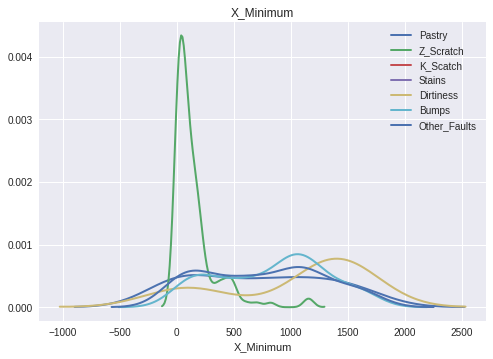

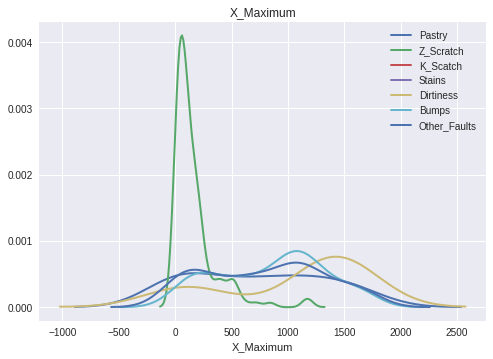

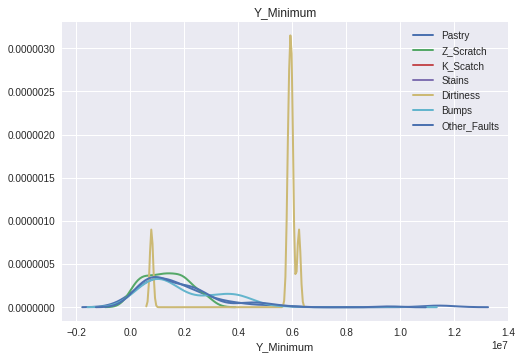

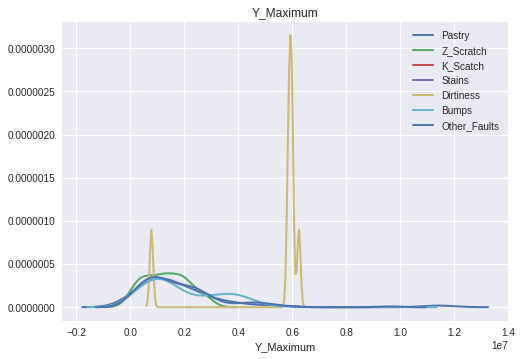

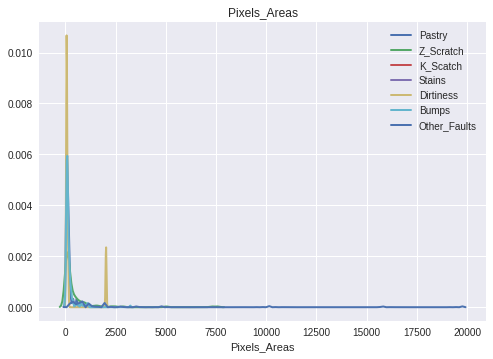

...

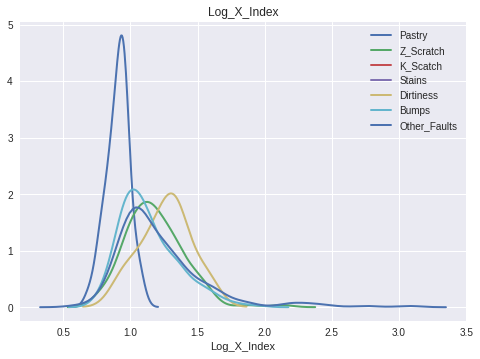

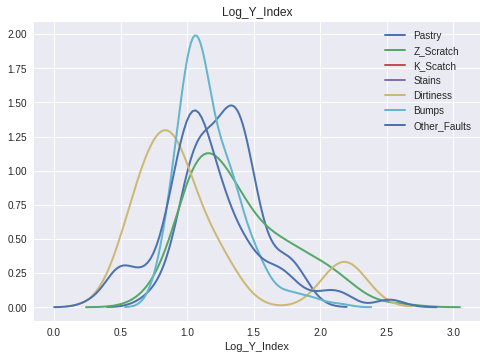

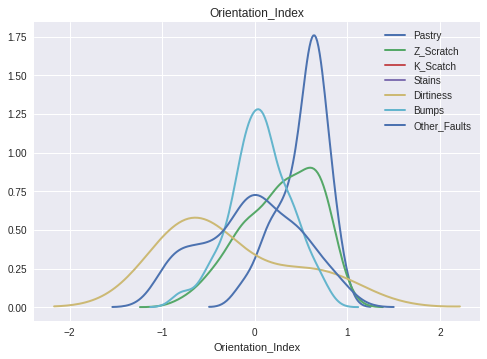

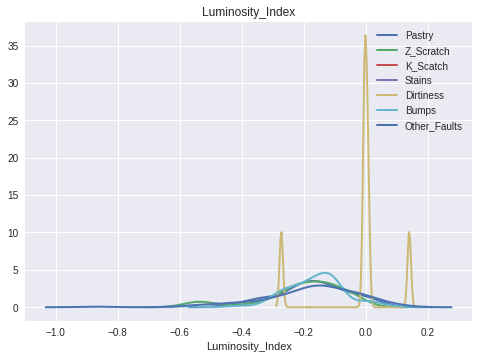

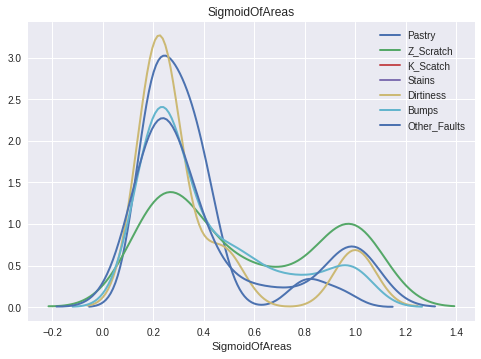

In [14]:
for feat in features:
  f, ax = plt.subplots()
  for defect in dummy_targets:
    subset = df[ (df['Defecto']==defect) & (df['TypeSteel'] == 'TypeOfSteel_A300')]
    sns.distplot(subset[feat], hist = False, kde = True, 
                 kde_kws = {'linewidth': 2},
                 label = defect)
    ax.set_title(feat)

In [15]:
subset = df[ (df['Defecto']=='Pastry') & (df['TypeSteel'] == 'TypeOfSteel_A400')]

corr = subset.corr
corr

<bound method DataFrame.corr of       X_Minimum  X_Maximum  Y_Minimum  Y_Maximum  Pixels_Areas  X_Perimeter  \
23          808        816     161967     161984           103           13   
82         1325       1334    1959035    1959052           112           16   
89          375        386    1063504    1063527           170           18   
104          90        104     751059     751132           552           38   
106         295        308   12725281   12725314           291           20   
133         669        684     491552     491684          1097           59   
136         757        766     487568     487588           121           13   
159         505        515     106604     106668           284           42   
164        1404       1410    5202306    5202324            85            9   
182         124        140    2377039    2377320          2643          165   
201         451        466     368143     368208           728           30   
250         450     

### Tipo de Acero A400

/usr/local/lib/python3.6/dist-packages/statsmodels/nonparametric/kde.py:494: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X,a,b,gridsize)/(delta*nobs)
/usr/local/lib/python3.6/dist-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2
/usr/local/lib/python3.6/dist-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


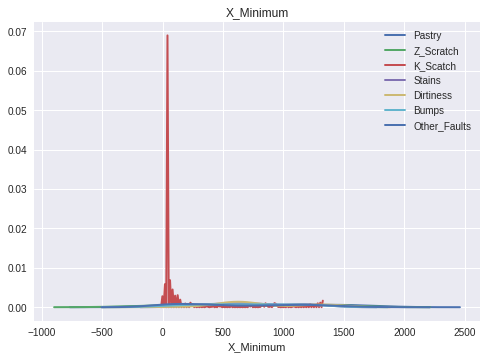

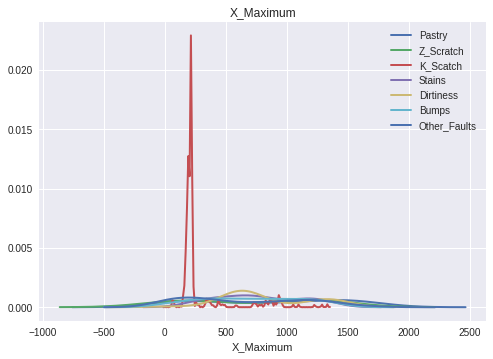

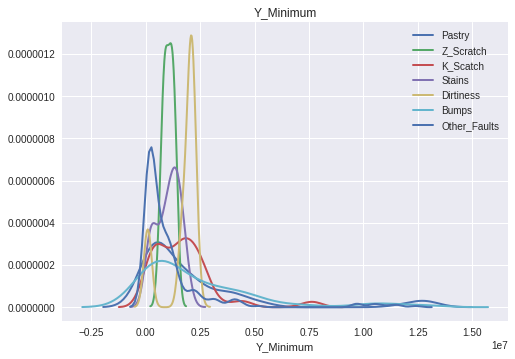

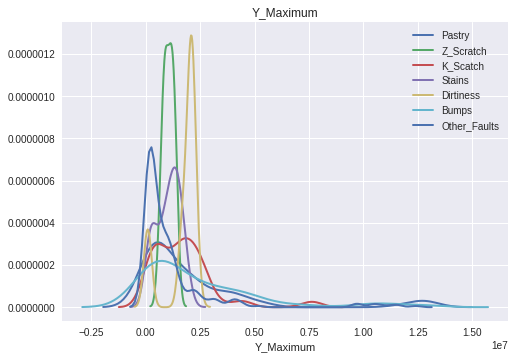

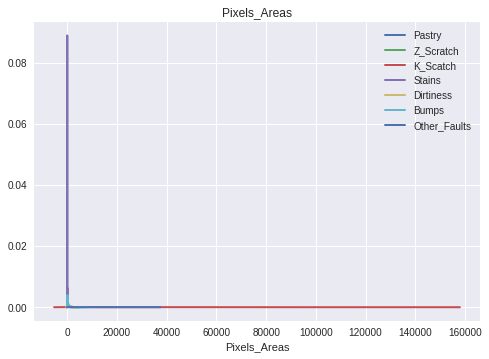

...

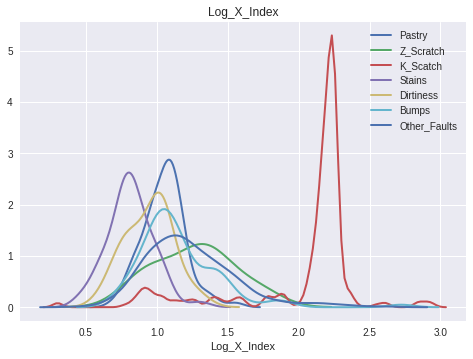

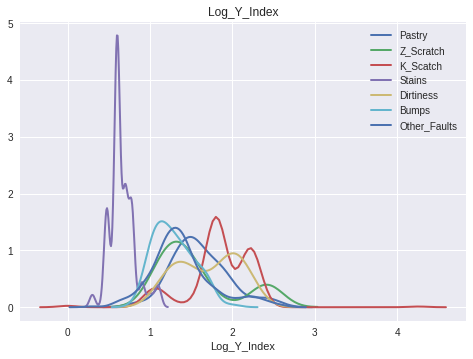

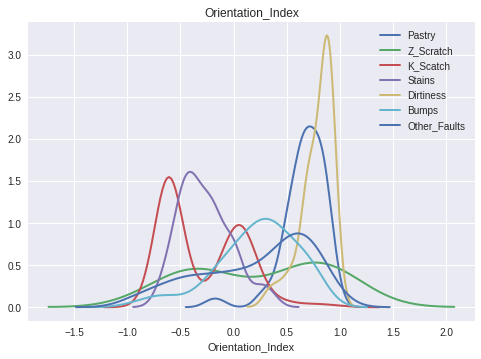

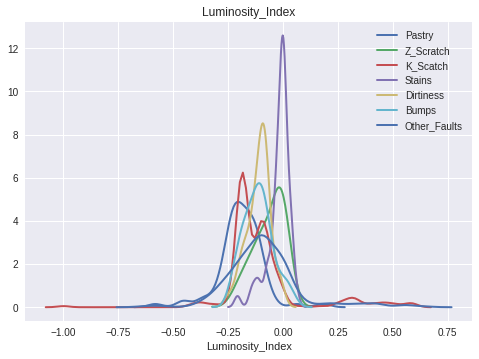

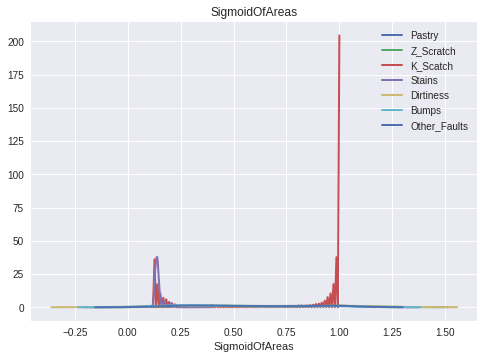

In [16]:
for feat in features:
  f, ax = plt.subplots()
  for defect in dummy_targets:
    subset = df[ (df['Defecto']==defect) & (df['TypeSteel'] == 'TypeOfSteel_A400')]
    sns.distplot(subset[feat], hist = False, kde = True, 
                 kde_kws = {'linewidth': 2},
                 label = defect)
    ax.set_title(feat)

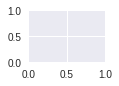

/usr/local/lib/python3.6/dist-packages/seaborn/categorical.py:1468: FutureWarning: remove_na is deprecated and is a private function. Do not use.
  confint = []


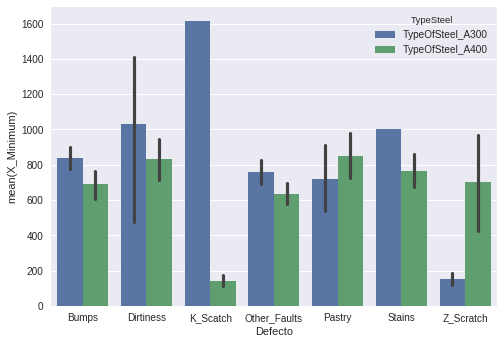

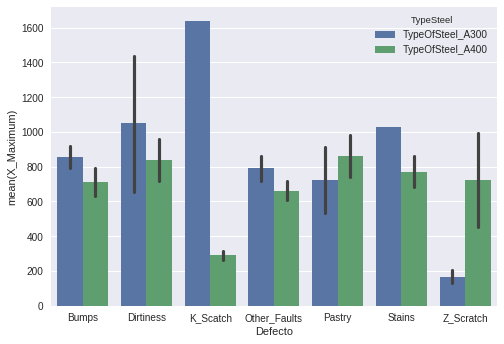

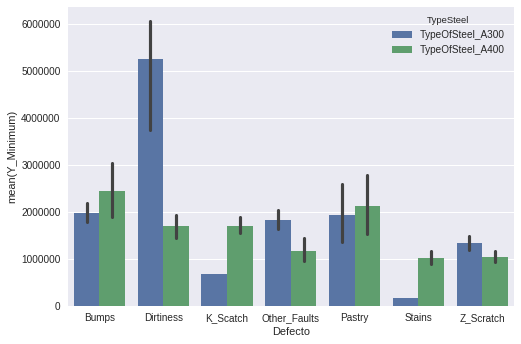

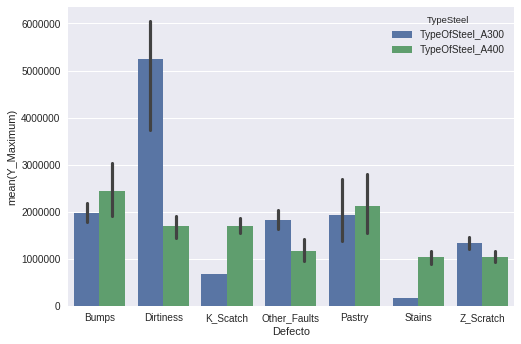

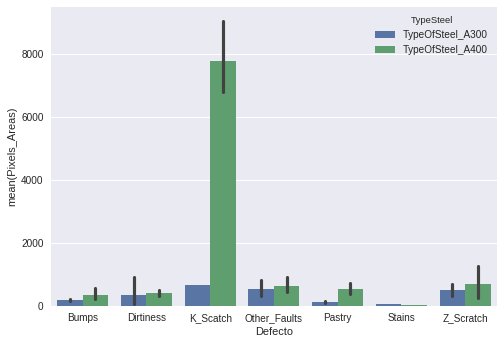

...

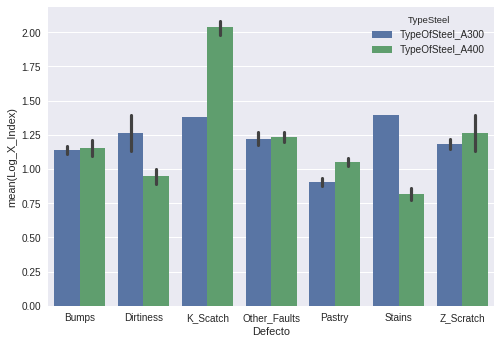

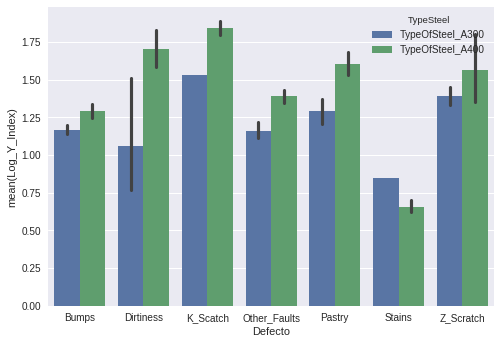

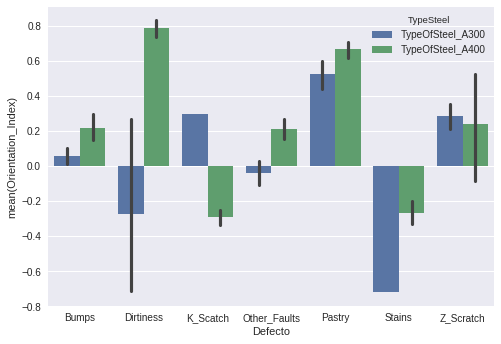

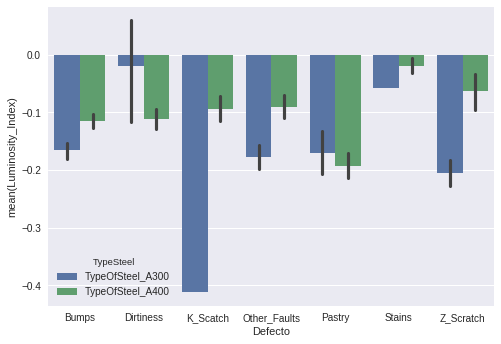

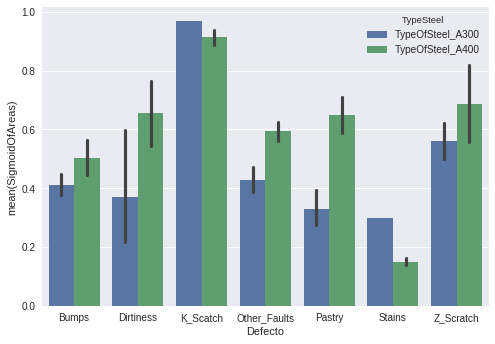

In [17]:
import seaborn as sns
plt.subplot(5,5,25)
plt.show()
for i in features_steel:
  sns.barplot(x='Defecto',y=i, hue='TypeSteel',data=df)
  plt.show()

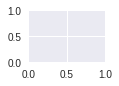

/usr/local/lib/python3.6/dist-packages/seaborn/categorical.py:1468: FutureWarning: remove_na is deprecated and is a private function. Do not use.
  confint = []


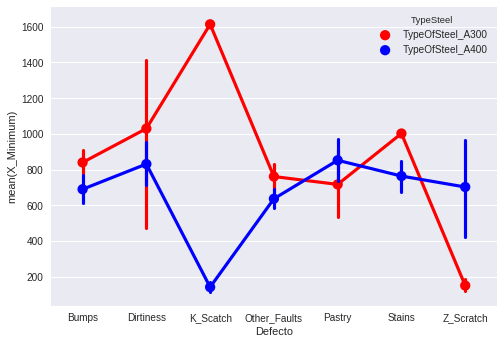

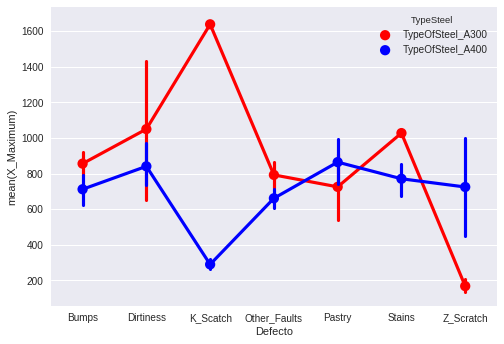

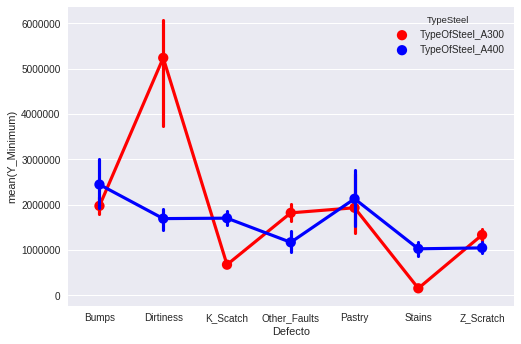

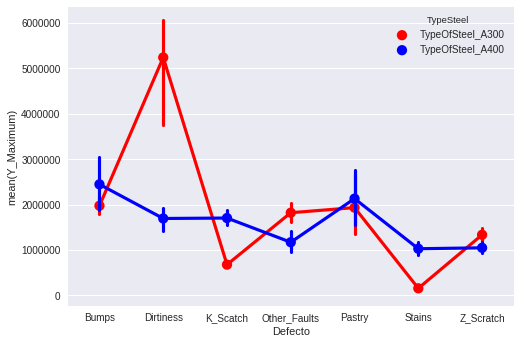

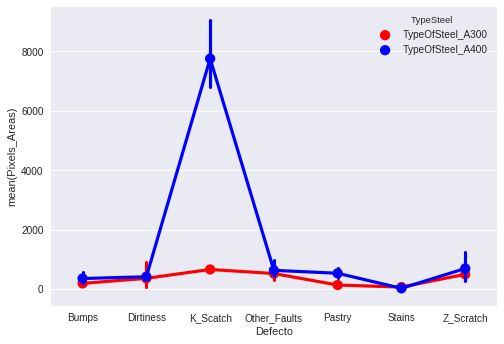

...

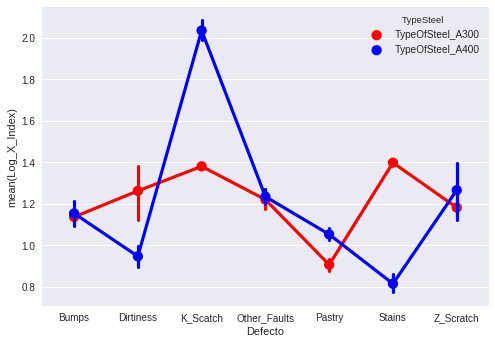

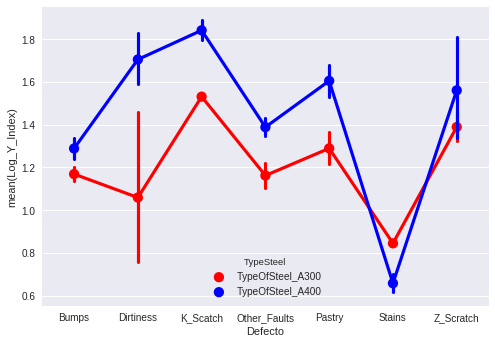

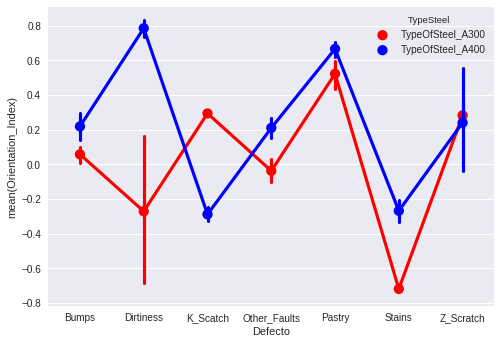

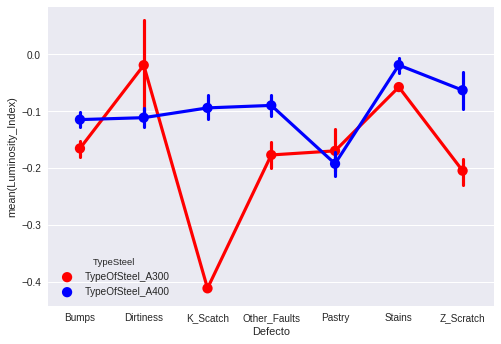

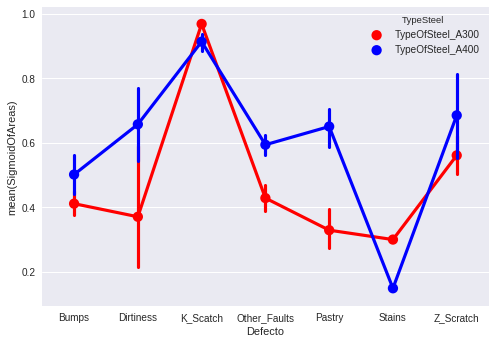

In [18]:
plt.subplot(5,5,25)
plt.show()
for i in features_steel:
  sns.pointplot(x='Defecto',y=i ,hue='TypeSteel',data=df,palette={'TypeOfSteel_A300':'red', 'TypeOfSteel_A400':'blue'})
  plt.show()


**Correlacion de variables**

In [0]:
from sklearn import preprocessing
# = df[features_steel + df['TypeSteel']=='TypeOfSteel_A300']
train_data = df[features_steel]
test_dataT300 = df[df['TypeSteel']=='TypeOfSteel_A300']
test_dataT400 = df[df['TypeSteel']=='TypeOfSteel_A400']

In [20]:
train_data.head(5)

,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas
0,1343,1351,46714,46725,56,11,11,5729,90,117,1362,70,0.0161,0.3636,0.7273,0.0059,0.7273,1.0000,1.0,1.7482,0.9031,1.0414,0.2727,-0.2007,0.1934
1,354,370,409908,409918,116,19,10,12174,82,126,1360,40,0.5206,0.2750,0.6250,0.0118,0.8421,1.0000,0.0,2.0645,1.2041,1.0000,-0.3750,-0.1801,0.2792
2,1056,1077,4364066,4364076,106,35,22,10747,89,116,1362,80,0.4185,0.4952,0.4762,0.0154,0.6000,0.4545,0.0,2.0253,1.3222,1.0000,-0.5238,-0.2079,0.3509
3,816,822,899659,899665,18,8,6,2384,127,141,1358,50,0.7894,0.5000,1.0000,0.0044,0.7500,1.0000,0.5,1.2553,0.7782,0.7782,0.0000,0.0347,0.1449
4,78,94,1523381,1523431,463,69,54,60518,118,141,1360,130,0.1147,0.4212,0.3200,0.0118,0.2319,0.9259,1.0,2.6656,1.2041,1.6990,0.6800,0.0212,0.9650


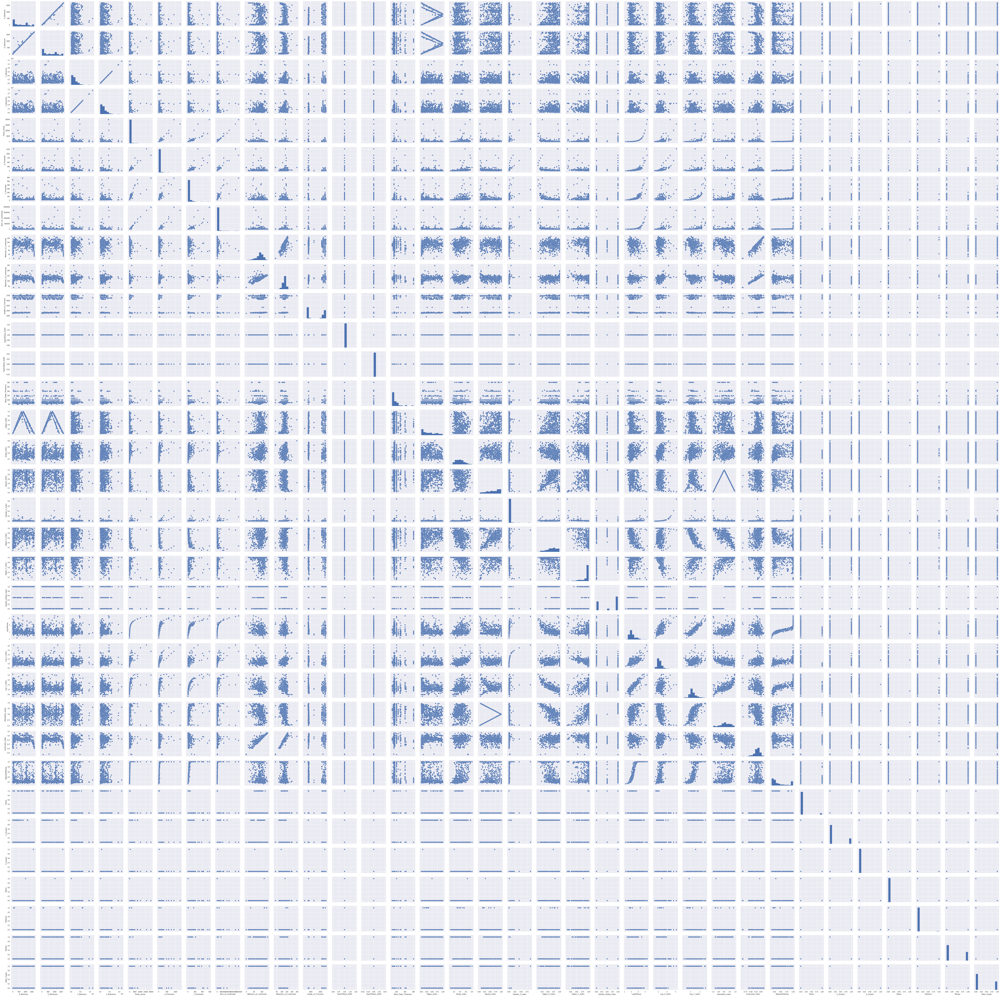

In [21]:
sns.pairplot(test_dataT300)
plt.show()

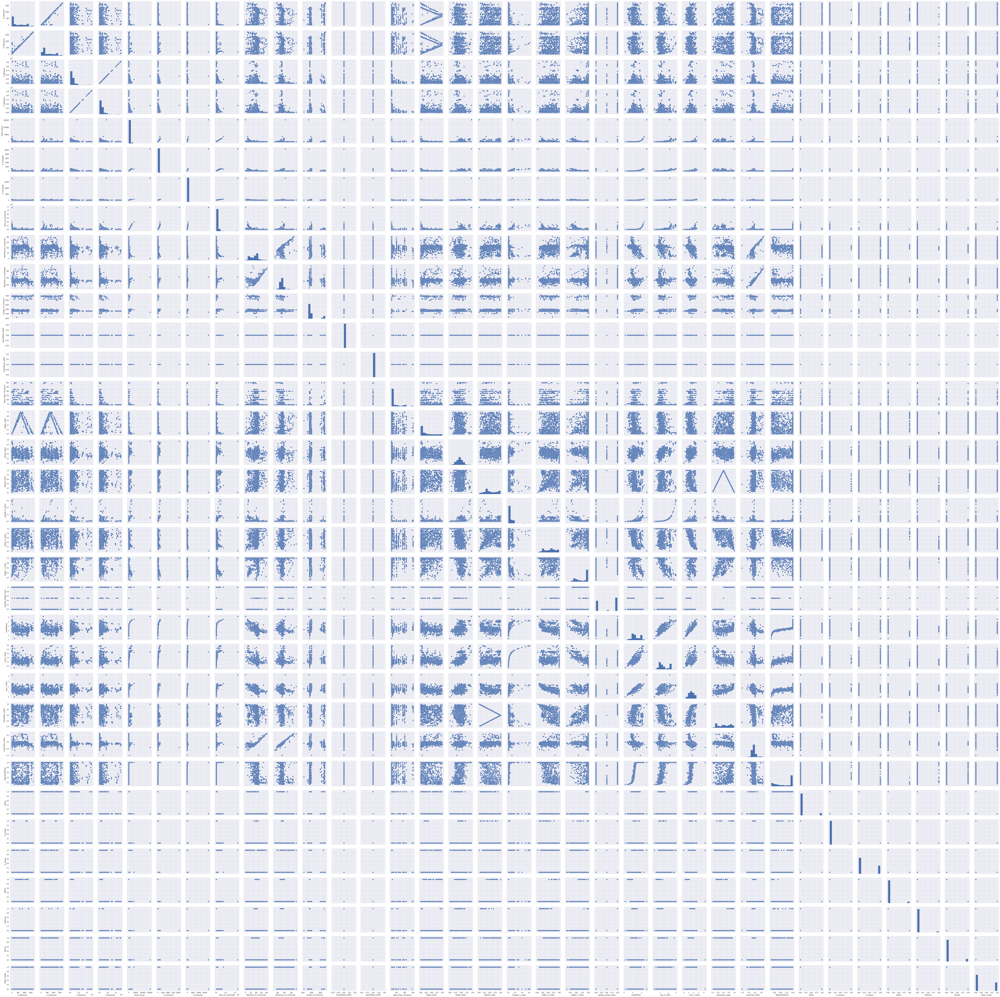

In [22]:
sns.pairplot(test_dataT400)
plt.show()

In [23]:
normalizer = preprocessing.MinMaxScaler()
X_train_norm = normalizer.fit_transform(train_data)

/usr/local/lib/python3.6/dist-packages/sklearn/preprocessing/data.py:323: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by MinMaxScaler.
  return self.partial_fit(X, y)


In [24]:
X_train_norm

array([[0.78768328, 0.78818022, 0.00308159, ..., 0.63420838, 0.48641073,
        0.08444949],
       [0.20762463, 0.21416033, 0.0310606 , ..., 0.30469068, 0.49896405,
        0.18183882],
       [0.61935484, 0.62785255, 0.33567299, ..., 0.2289886 , 0.48202316,
        0.26322361],
       ...,
       [0.06392962, 0.06846109, 0.04265582, ..., 0.69897232, 0.5195003 ,
        0.31634506],
       [0.21876833, 0.22352253, 0.08100548, ..., 0.83465608, 0.57531993,
        0.76912599],
       [0.0228739 , 0.10181393, 0.20187407, ..., 0.56771469, 0.52894576,
        1.        ]])

In [0]:
dummy_targets_dic = {'Pastry':1, 'Z_Scratch':2, 'K_Scatch':3, 'Stains':4, 'Dirtiness':5, 'Bumps':6, 'Other_Faults':7}

In [0]:
test_dic = dict()
defects_list= []
for j in df['Defecto']:
  #print( dummy_targets_dic[j])
  #print(j)
  defects_list.append(dummy_targets_dic[j])


In [0]:
df['Defecto_N'] = defects_list

In [28]:
df['Defecto_N'].values

array([7, 6, 6, ..., 2, 7, 3])

In [0]:
train_dict = {'data':X_train_norm, 'columns':train_data.columns,'target':df['Defecto_N'].values , 'target_names':dummy_targets}

In [30]:
train_dict['data']

array([[0.78768328, 0.78818022, 0.00308159, ..., 0.63420838, 0.48641073,
        0.08444949],
       [0.20762463, 0.21416033, 0.0310606 , ..., 0.30469068, 0.49896405,
        0.18183882],
       [0.61935484, 0.62785255, 0.33567299, ..., 0.2289886 , 0.48202316,
        0.26322361],
       ...,
       [0.06392962, 0.06846109, 0.04265582, ..., 0.69897232, 0.5195003 ,
        0.31634506],
       [0.21876833, 0.22352253, 0.08100548, ..., 0.83465608, 0.57531993,
        0.76912599],
       [0.0228739 , 0.10181393, 0.20187407, ..., 0.56771469, 0.52894576,
        1.        ]])

In [0]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import KFold
import sklearn.metrics as metrics
from sklearn import tree
from math import sqrt

In [0]:
# Construcción del algoritmo de aprendizaje.
seed = 1

algoritmos = {'LOGR': LogisticRegression(solver='sag',
                      max_iter=1000, random_state=seed,
                      multi_class='ovr'),
             'DT': tree.DecisionTreeClassifier()}

In [0]:
# Métricas de evaluación.
metricas = {
  'ACC':    metrics.accuracy_score,
  'PREC':   lambda y_true, y_pred:
            metrics.precision_score(y_true, y_pred,
              average='micro'),
  'RECALL': lambda y_true, y_pred:
            metrics.recall_score(y_true, y_pred,
              average='micro'),
  'F1':     lambda y_true, y_pred:
            metrics.f1_score(y_true, y_pred, average='micro')}

In [0]:
# Validación y obtención de las predicciones del modelo.
seed = 1
y_pred = {}
for nombre, alg in algoritmos.items():
    y_pred[nombre] = cross_val_predict(alg,train_dict['data'],train_dict['target'], cv = KFold(n_splits=10, random_state=seed))

In [0]:
def evaluacion(y_true, y_pred, metricas):
    res = {}
    for nombre, funcion in metricas.items():
        res[nombre] = funcion(y_true, y_pred)
    return res
  # Grafica con mapa de regiones de clasificacion segun modelo ya entrenado que admita coef_ e intercept_.
def mapa_modelo_clasif_2d(X, y, modelo, metricas, algoritmo):
    # create a mesh to plot in
    h = .02  # step size in the mesh
    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                         np.arange(y_min, y_max, h))

    # Plot the decision boundary. For that, we will assign a color to each
    # point in the mesh [x_min, x_max]x[y_min, y_max].
    Z = modelo.predict(np.c_[xx.ravel(), yy.ravel()])

    # Put the result into a color plot
    Z = Z.reshape(xx.shape)
    plt.figure(figsize=(20,16))
    plt.contourf(xx, yy, Z, cmap=plt.cm.Paired)
    plt.title("%s\nACC: %.3f  PREC: %.3f  RECALL: %.3f  F1: %.3f" %
              (algoritmo,metricas['ACC'],metricas['PREC'],metricas['RECALL'],metricas['F1']), fontsize=28)
    plt.axis('tight')

    # Plot also the training points
    colors = "bry"
    for i, color in zip(modelo.classes_, colors):
        idx = np.where(y == i)
        plt.scatter(X[idx, 0], X[idx, 1], c=color, cmap=plt.cm.Paired,
                    edgecolor='black', s=20)

    # Plot the three one-against-all classifiers
    if (hasattr(modelo, 'coef_')):
        xmin, xmax = plt.xlim()
        ymin, ymax = plt.ylim()
        coef = modelo.coef_
        intercept = modelo.intercept_

        def plot_hyperplane(c, color):
            def line(x0):
                return (-(x0 * coef[c, 0]) - intercept[c]) / coef[c, 1]

            plt.plot([xmin, xmax], [line(xmin), line(xmax)],
                     ls="--", color=color)

        for i, color in zip(modelo.classes_, colors):
            plot_hyperplane(i, color)

    plt.show()

In [100]:
train_dict['columns']

Index(['X_Minimum', 'X_Maximum', 'Y_Minimum', 'Y_Maximum', 'Pixels_Areas',
       'X_Perimeter', 'Y_Perimeter', 'Sum_of_Luminosity',
       'Minimum_of_Luminosity', 'Maximum_of_Luminosity', 'Length_of_Conveyer',
       'Steel_Plate_Thickness', 'Edges_Index', 'Empty_Index', 'Square_Index',
       'Outside_X_Index', 'Edges_X_Index', 'Edges_Y_Index',
       'Outside_Global_Index', 'LogOfAreas', 'Log_X_Index', 'Log_Y_Index',
       'Orientation_Index', 'Luminosity_Index', 'SigmoidOfAreas'],
      dtype='object')

In [102]:
# Evaluación y presentación de resultados.
for nombre, alg in algoritmos.items():
    eval = evaluacion(train_dict['target'], y_pred[nombre], metricas)
    modelo_completo = alg.fit(train_dict['data'], train_dict['target'])
   # mapa_modelo_clasif_2d(train_dict['data'], train_dict['target'], modelo_completo, eval, nombre)
    print("Matriz de confusión (%s):\n%s" % (nombre, metrics.confusion_matrix(train_dict['target'], y_pred[nombre])))
    print("Tabla de métricas (%s):\n%s" % (nombre, metrics.classification_report(train_dict['target'], y_pred[nombre], digits=3)))

Matriz de confusión (LOGR):
[[ 33  14   0   0   1  14  56]
 [  0  95   8   0   0   4  38]
 [  1   1 260   3   0   9  20]
 [  0   0   0  30   0   5  19]
 [  4   0   0   0   7   1  30]
 [  3  11   6   1   0 161 120]
 [ 22  38  19   2   1  86 332]]
Tabla de métricas (LOGR):
              precision    recall  f1-score   support

           1      0.524     0.280     0.365       118
           2      0.597     0.655     0.625       145
           3      0.887     0.884     0.886       294
           4      0.833     0.556     0.667        54
           5      0.778     0.167     0.275        42
           6      0.575     0.533     0.553       302
           7      0.540     0.664     0.596       500

   micro avg      0.631     0.631     0.631      1455
   macro avg      0.676     0.534     0.566      1455
weighted avg      0.640     0.631     0.623      1455

Matriz de confusión (DT):
[[ 51   1   2   0   3  24  37]
 [  2 118   3   0   0   5  17]
 [  1   3 270   0   0   4  16]
 [  0   1   

In [0]:
#{'Pastry':1, 'Z_Scratch':2, 'K_Scatch':3, 'Stains':4, 'Dirtiness':5, 'Bumps':6, 'Other_Faults':7}

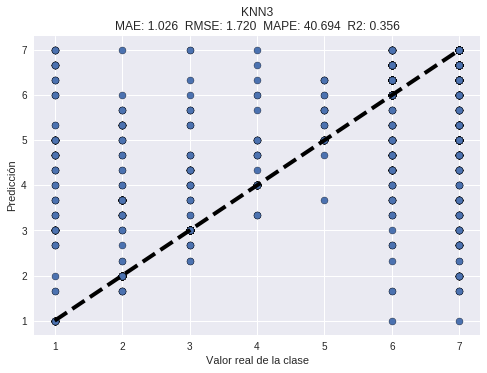

# Se descartaron tipos de defecto con población baja

In [103]:
train_data_filter = df[ (df['Defecto_N'] != 4) & (df['Defecto_N'] != 5)]
train_data_filter.drop(['Pastry','Z_Scratch','K_Scatch','Stains','Dirtiness','Bumps','Other_Faults','Defecto','TypeSteel','TypeOfSteel_A300','TypeOfSteel_A400'], axis=1, inplace=True)
train_data_filter.head(5)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


,X_Minimum,X_Maximum,Y_Minimum,Y_Maximum,Pixels_Areas,X_Perimeter,Y_Perimeter,Sum_of_Luminosity,Minimum_of_Luminosity,Maximum_of_Luminosity,Length_of_Conveyer,Steel_Plate_Thickness,Edges_Index,Empty_Index,Square_Index,Outside_X_Index,Edges_X_Index,Edges_Y_Index,Outside_Global_Index,LogOfAreas,Log_X_Index,Log_Y_Index,Orientation_Index,Luminosity_Index,SigmoidOfAreas,Defecto_N
0,1343,1351,46714,46725,56,11,11,5729,90,117,1362,70,0.0161,0.3636,0.7273,0.0059,0.7273,1.0000,1.0,1.7482,0.9031,1.0414,0.2727,-0.2007,0.1934,7
1,354,370,409908,409918,116,19,10,12174,82,126,1360,40,0.5206,0.2750,0.6250,0.0118,0.8421,1.0000,0.0,2.0645,1.2041,1.0000,-0.3750,-0.1801,0.2792,6
2,1056,1077,4364066,4364076,106,35,22,10747,89,116,1362,80,0.4185,0.4952,0.4762,0.0154,0.6000,0.4545,0.0,2.0253,1.3222,1.0000,-0.5238,-0.2079,0.3509,6
4,78,94,1523381,1523431,463,69,54,60518,118,141,1360,130,0.1147,0.4212,0.3200,0.0118,0.2319,0.9259,1.0,2.6656,1.2041,1.6990,0.6800,0.0212,0.9650,7
5,618,650,2017425,2017438,103,51,20,13657,124,141,1358,40,0.9102,0.7524,0.4063,0.0236,0.6274,0.6500,0.0,2.0128,1.5051,1.1139,-0.5938,0.0359,0.6810,7


In [111]:
X_train_norm_filter = normalizer.fit_transform(train_data_filter)
X_train_norm_filter

/usr/local/lib/python3.6/dist-packages/sklearn/preprocessing/data.py:323: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by MinMaxScaler.
  return self.partial_fit(X, y)


array([[0.78768328, 0.78818022, 0.00308159, ..., 0.48641073, 0.08444949,
        1.        ],
       [0.20762463, 0.21416033, 0.0310606 , ..., 0.49896405, 0.18183882,
        0.83333333],
       [0.61935484, 0.62785255, 0.33567299, ..., 0.48202316, 0.26322361,
        0.83333333],
       ...,
       [0.06392962, 0.06846109, 0.04265582, ..., 0.5195003 , 0.31634506,
        0.16666667],
       [0.21876833, 0.22352253, 0.08100548, ..., 0.57531993, 0.76912599,
        1.        ],
       [0.0228739 , 0.10181393, 0.20187407, ..., 0.52894576, 1.        ,
        0.33333333]])

In [0]:
dummy_targets_filter=['Pastry','Z_Scratch','K_Scatch','Bumps','Other_Faults']

In [0]:
train_filter_dict = {'data':X_train_norm_filter, 'columns':train_data_filter.columns,'target':train_data_filter['Defecto_N'].values , 'target_names':dummy_targets_filter}

In [113]:
train_filter_dict

{'columns': Index(['X_Minimum', 'X_Maximum', 'Y_Minimum', 'Y_Maximum', 'Pixels_Areas',
        'X_Perimeter', 'Y_Perimeter', 'Sum_of_Luminosity',
        'Minimum_of_Luminosity', 'Maximum_of_Luminosity', 'Length_of_Conveyer',
        'Steel_Plate_Thickness', 'Edges_Index', 'Empty_Index', 'Square_Index',
        'Outside_X_Index', 'Edges_X_Index', 'Edges_Y_Index',
        'Outside_Global_Index', 'LogOfAreas', 'Log_X_Index', 'Log_Y_Index',
        'Orientation_Index', 'Luminosity_Index', 'SigmoidOfAreas', 'Defecto_N'],
       dtype='object'),
 'data': array([[0.78768328, 0.78818022, 0.00308159, ..., 0.48641073, 0.08444949,
         1.        ],
        [0.20762463, 0.21416033, 0.0310606 , ..., 0.49896405, 0.18183882,
         0.83333333],
        [0.61935484, 0.62785255, 0.33567299, ..., 0.48202316, 0.26322361,
         0.83333333],
        ...,
        [0.06392962, 0.06846109, 0.04265582, ..., 0.5195003 , 0.31634506,
         0.16666667],
        [0.21876833, 0.22352253, 0.08100548, ...

In [0]:
# Validación y obtención de las predicciones del modelo.
seed = 1
y_pred = {}
for nombre, alg in algoritmos.items():
    y_pred[nombre] = cross_val_predict(alg,train_filter_dict['data'],train_filter_dict['target'], cv = KFold(n_splits=10, random_state=seed))

In [115]:
# Evaluación y presentación de resultados.
for nombre, alg in algoritmos.items():
    eval = evaluacion(train_filter_dict['target'], y_pred[nombre], metricas)
    modelo_completo = alg.fit(train_filter_dict['data'], train_filter_dict['target'])
    print("Matriz de confusión (%s):\n%s" % (nombre, metrics.confusion_matrix(train_filter_dict['target'], y_pred[nombre])))
    print("Tabla de métricas (%s):\n%s" % (nombre, metrics.classification_report(train_filter_dict['target'], y_pred[nombre], digits=3)))

Matriz de confusión (LOGR):
[[102  16   0   0   0]
 [  7 128  10   0   0]
 [  4   4 285   1   0]
 [  0   0   1 196 105]
 [  0   0   0  17 483]]
Tabla de métricas (LOGR):
              precision    recall  f1-score   support

           1      0.903     0.864     0.883       118
           2      0.865     0.883     0.874       145
           3      0.963     0.969     0.966       294
           6      0.916     0.649     0.760       302
           7      0.821     0.966     0.888       500

   micro avg      0.879     0.879     0.879      1359
   macro avg      0.894     0.866     0.874      1359
weighted avg      0.885     0.879     0.874      1359

Matriz de confusión (DT):
[[118   0   0   0   0]
 [  0 145   0   0   0]
 [  0   0 294   0   0]
 [  0   0   0 302   0]
 [  0   0   0   0 500]]
Tabla de métricas (DT):
              precision    recall  f1-score   support

           1      1.000     1.000     1.000       118
           2      1.000     1.000     1.000       145
           3